# COMP0026 - Image Processing


# 2021/22 Coursework 2 - Poisson Image editing

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.sparse as sparse
import scipy.sparse.linalg as linalg
import cv2

## Helper Functions

In [2]:
# input the image path and return a numpy array of the image
def loadImage(path):
    img = np.array(cv2.imread(path, cv2.IMREAD_COLOR))
    # convert from BGR to RGB
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

# input the image path and return a numpy array of the image
def loadGrayImage(path):
    img = np.array(cv2.imread(path, cv2.IMREAD_GRAYSCALE))
    return img

In [3]:
# plot 1 image
def plotImage(img, title):
    plt.figure(figsize = (15,15))
    plt.title(title)
    if len(img.shape) == 2:
        plt.imshow(img, cmap='Greys_r')
    else:
        plt.imshow(img)
    
# plot 2 images   
def plot2Images(img1, img2, title1, title2):
    fig = plt.figure(figsize=(15, 15))
    ax1 = plt.subplot(2, 1, 1)
    ax1.title.set_text(title1)
    if len(img1.shape) == 2:
        plt.imshow(img1, cmap='Greys_r')
    else:
        plt.imshow(img1)
    ax2 = plt.subplot(2, 1, 2)
    ax2.title.set_text(title2)
    if len(img2.shape) == 2:
        plt.imshow(img2, cmap='Greys_r')
    else:
        plt.imshow(img2)

# plot 3 images
def plot3Images(img1, img2, img3, title1, title2, title3):
    fig = plt.figure(figsize=(15, 15))
    ax1 = plt.subplot(1, 3, 1)
    ax1.title.set_text(title1)
    if len(img1.shape) == 2:
        plt.imshow(img1, cmap='Greys_r')
    else:
        plt.imshow(img1)
    ax2 = plt.subplot(1, 3, 2)
    ax2.title.set_text(title2)
    if len(img2.shape) == 2:
        plt.imshow(img2, cmap='Greys_r')
    else:
        plt.imshow(img2)
    ax3 = plt.subplot(1, 3, 3)
    ax3.title.set_text(title3)
    if len(img3.shape) == 2:
        plt.imshow(img3, cmap='Greys_r')
    else:
        plt.imshow(img3)

In [4]:
def getMaskByVertices(img, vertices):
    mask = np.zeros((img.shape[0], img.shape[1]))
    mask = cv2.fillPoly(mask, [vertices], (1,1))
    if len(img.shape) == 3:
        mask = np.zeros((img.shape[0], img.shape[1], 3))
        mask = cv2.fillPoly(mask, [vertices], (1,1,1))
    mask = cv2.convertScaleAbs(mask)
    
    return mask

In [5]:
def getTargetMask(img, rect, croppedSrcMask):
    mask = np.zeros(img.shape, img.dtype)
    x,y,w,h = rect
    mask[y:y+h, x:x+w] = croppedSrcMask
    
    return mask

In [6]:
def getBoundingBoxOfPolygon(vertices):
    #verticesArr = np.array(vertices)
    topLeft = np.amin(vertices, axis=0)
    bottomRight = np.amax(vertices, axis=0)
    x = topLeft[0]
    y = topLeft[1]
    w = bottomRight[0] + 1 - x
    h = bottomRight[1] + 1 - y
    return (x,y,w,h)

In [7]:
def padRect(rect, left, right, top, bottom):
    x,y,w,h = rect
    newX = x - left
    newY = y - top
    newW = w + left + right
    newH = h + top + bottom
    return(newX, newY, newW, newH)

In [8]:
def getVerticesInBoundingBox(vertices, rect):
    x,y,w,h = rect
    newVertices = np.array(vertices).astype(int)
    newVertices[:,0] -= x
    newVertices[:,1] -= y
    
    return newVertices

In [9]:
def cropImg(img, rect):
    x,y,w,h = rect
    croppedImg = img[y : y + h, x : x + w]
    return croppedImg

In [10]:
def putCroppedResultImgToTarget(targetImg, croppedResultImg, targetRect):
    outImg = np.array(targetImg, dtype=np.int32)
    x,y,w,h = targetRect
    if len(targetImg.shape) == 3:
        outImg[y:y+h, x:x+w, :] = croppedResultImg
    else:
        outImg[y:y+h, x:x+w] = croppedResultImg
    
    return outImg.astype(np.uint8)

In [11]:
def directCloning(targetImg, targetMask, croppedSrcImg, croppedSrcMask, targetRect):
    maskedTargetImg = targetImg * (1 - targetMask)
    x,y,w,h = targetRect
    if len(targetImg.shape) == 3:
        maskedTargetImg[y:y+h, x:x+w, :] += croppedSrcImg * croppedSrcMask
    else:
        maskedTargetImg[y:y+h, x:x+w] += croppedSrcImg * croppedSrcMask
        
    return maskedTargetImg

## Select Region Interactively

In [12]:
def onMouseClick1(event, x, y, flags, params):
    vertices = params['vertices']
    img = params['img']
    # checking for left mouse clicks
    if event == cv2.EVENT_LBUTTONDOWN:
        print(x, ' ', y)
        vertices.append([x,y])
        # displaying the coordinates on the image window
        font = cv2.FONT_HERSHEY_SIMPLEX
        cv2.putText(img, str(x) + ',' +
                    str(y), (x,y), font,
                    0.7, (255, 100, 0), 2)
        cv2.imshow('image', img)

In [13]:
def getRegionVerticesFromImg(imgPath):
    # reading the color image
    img = cv2.imread(imgPath, 1)

    # displaying the image
    cv2.imshow('image', img)
    
    vertices = []
    params = {"img": img, 
              "vertices": vertices}

    cv2.setMouseCallback('image', onMouseClick1, params)

    # wait for a key to be pressed to exit
    cv2.waitKey(0)

    # close the window
    cv2.destroyAllWindows()
    cv2.waitKey(1)
    
    print("number of vertices: ", len(vertices))
    print("vertices: ", vertices)
    
    vertices = np.asarray(vertices).astype(int)
    
    return vertices

In [14]:
def onMouseClick2(event, x, y, flags, params):
    topLeft = params['topLeft']
    img = params['img']
    rect = params['rect']
    tlx,tly,w,h = rect
    newImg = img.copy()
    # checking for left mouse clicks
    if event == cv2.EVENT_LBUTTONDOWN:
        topLeft[0] = x
        topLeft[1] = y
        # displaying the coordinates on the image window
        font = cv2.FONT_HERSHEY_SIMPLEX
        cv2.putText(newImg, str(x) + ',' +
                    str(y), (x,y), font,
                    0.7, (255, 100, 0), 2)
        cv2.rectangle(newImg,(x,y),(x+w, y+h),(0,255,0),2)
        cv2.imshow('image', newImg)

In [15]:
def selectRegionToPutOnImg(imgPath, rect):
    # reading the color image
    img = cv2.imread(imgPath, 1)

    # displaying the image
    cv2.imshow('image', img)
    
    topLeft = [0,0]
    params = {"img": img,
              "rect": rect,
              "topLeft": topLeft}

    # setting mouse handler for the image and calling the clickEvent() function
    cv2.setMouseCallback('image', onMouseClick2, params)

    # wait for a key to be pressed to exit
    cv2.waitKey(0)

    # close the window
    cv2.destroyAllWindows()
    cv2.waitKey(1)
    
    newRect = (topLeft[0], topLeft[1], rect[2], rect[3])
    
    return newRect

In [16]:
def markRegionOnSrcImg(srcImgPath, srcImg):
    vertices = getRegionVerticesFromImg(srcImgPath)
    srcMask = getMaskByVertices(srcImg, vertices)
    rect = getBoundingBoxOfPolygon(vertices)
    paddedRect = padRect(rect, 1,1,1,1)
    croppedVertices = getVerticesInBoundingBox(vertices, paddedRect)
    croppedSrcImg = cropImg(srcImg, paddedRect)
    croppedSrcMask = cropImg(srcMask, paddedRect) 
    
    return croppedSrcImg, croppedSrcMask, croppedVertices

In [17]:
def putMarkRegionOnTargetImg(targetImgPath, targetImg, croppedSrcImg, croppedSrcMask):
    h = 0
    w = 0
    d = 0
    if len(croppedSrcImg.shape) == 3:
        h,w,d = croppedSrcImg.shape
    else:
        h,w = croppedSrcImg.shape
    rect = selectRegionToPutOnImg(targetImgPath, (0,0,w,h))
    targetMask = getTargetMask(targetImg, rect, croppedSrcMask)
    croppedTargetImg = cropImg(targetImg, rect)
    maskedTargetImg = targetImg * (1 - targetMask)
    croppedMaskedTargetImg = cropImg(maskedTargetImg, rect)
    
    return croppedTargetImg, maskedTargetImg, croppedMaskedTargetImg, targetMask, rect

# 1.) Construct Sparse Matrix

In [18]:
# create a matrix to store the index of the pixel that is within the region
# the value of points within the region will be its own index
# the value of points outside the region will be -1 
def getPointIndexMatrixAndPointCoordList(mask):
    height, width = mask.shape
    pointIndexMatrix = np.full(mask.shape, -1)
    pointCoordList = []
    index = 0
    
    for i in range(height):
        for j in range(width):
            # if the current point of the mask is 0, continue
            if mask[i][j] == 0:
                continue
            # otherwise, assign an index for the current point
            pointIndexMatrix[i][j] = index
            # store the coordinate for each points with the region
            pointCoordList.append([j,i])
            index += 1
    
    return pointIndexMatrix.astype(int), pointCoordList

In [19]:
# create the sparse matrix
# the diagonal will be 4,
# other non-diagonal elements will be either 0 or -1, 
# and each row of the sparse matrix will have a maximum of four -1 element
# since we are only checking the 4 neighbours(left, right, up, down) for the Laplacian
def createSparseMatrixA(pointIndexMatrix, pointCoordList):
    matARow = []
    matAColumn = []
    
    for point in pointCoordList:
        x = point[0]
        y = point[1]
        
        centerIndex = pointIndexMatrix[y][x]
        rightIndex = pointIndexMatrix[y][x+1]
        leftIndex = pointIndexMatrix[y][x-1]
        downIndex = pointIndexMatrix[y+1][x]
        upIndex = pointIndexMatrix[y-1][x]
        
        if rightIndex != -1:
            matARow.append(centerIndex)
            matAColumn.append(rightIndex)
            
        if downIndex != -1:
            matARow.append(centerIndex)
            matAColumn.append(downIndex)
            
        if leftIndex != -1:
            matARow.append(centerIndex)
            matAColumn.append(leftIndex)

        if upIndex != -1:
            matARow.append(centerIndex)
            matAColumn.append(upIndex)
    
    matARowArr = np.array(matARow)
    matAColArr = np.array(matAColumn)
    data = np.full(len(matARow), -1)
    n = len(pointCoordList)
    
    matA = sparse.coo_matrix((data, (matARowArr, matAColArr)), shape=(n,n))
    matA.setdiag(4)
    matA = sparse.csr_matrix(matA)
    
    return matA.astype(int)

# 2.) Task 1 - Poisson Image Editing with Zero Gradient

In [20]:
def createMatrixB_ZeroGradient(img, pointIndexMatrix, pointCoordList):
    n = len(pointCoordList)
    matB = np.zeros(n)
    
    for point in pointCoordList:
        x = point[0]
        y = point[1]
        
        centerIndex = pointIndexMatrix[y][x]
        rightIndex = pointIndexMatrix[y][x+1]
        leftIndex = pointIndexMatrix[y][x-1]
        downIndex = pointIndexMatrix[y+1][x]
        upIndex = pointIndexMatrix[y-1][x]
        
        if rightIndex == -1:
            matB[centerIndex] += img[y][x+1]
            
        if downIndex == -1:
            matB[centerIndex] += img[y+1][x]
            
        if leftIndex == -1:
            matB[centerIndex] += img[y][x-1]

        if upIndex == -1:
            matB[centerIndex] += img[y-1][x]
        
    return matB

In [21]:
def fillRegion(imgPath, img):
    # select a region on the image and get a list of vertices coordinates
    vertices = getRegionVerticesFromImg(imgPath)
    # get a mask using the vertices list
    mask = getMaskByVertices(img, vertices)
    # create a matrix to store the index of the pixel that is within the selected region
    # also store those pixel's coordinate to a list
    pointIndexMatrix, pointCoordList = getPointIndexMatrixAndPointCoordList(mask)
    # Linear Equation: Ax = B, solving for x which is the unknown intensity inside the selected region
    matA = createSparseMatrixA(pointIndexMatrix, pointCoordList)
    matB = createMatrixB_ZeroGradient(img, pointIndexMatrix, pointCoordList)
    matX = linalg.cg(matA, matB)
    # put solved intensity value back to the corresponding position for each pixel
    resultImg = np.array(img)
    for index, point in enumerate(pointCoordList):
        x = point[0]
        y = point[1]
        resultImg[y][x] = matX[0][index]
        
    return resultImg.astype(int)

Select a region on the image. Then remove the selected region and fill in the intensity using Poisson Equation.

421   197
326   300
419   386
603   381
670   286
572   172
number of vertices:  6
vertices:  [[421, 197], [326, 300], [419, 386], [603, 381], [670, 286], [572, 172]]


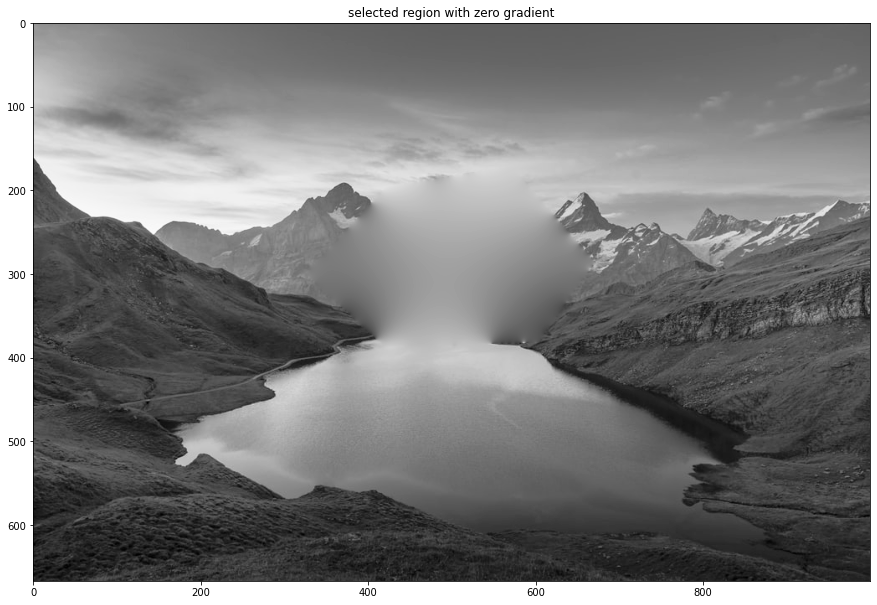

In [22]:
targetImgPath = "./images/lake1.jpeg"
targetImg = loadGrayImage(targetImgPath)
resultImg_ZeroGradient = fillRegion(targetImgPath, targetImg)
plotImage(resultImg_ZeroGradient, "selected region with zero gradient")

In [23]:
cv2.imwrite("task1.jpg", resultImg_ZeroGradient)

True

# 3.) Task 2a - Seamless Cloning by Importing Gradient

In [24]:
def createMatrixB_ImportingGradient(srcImg, img, pointIndexMatrix, pointCoordList):
    n = len(pointCoordList)
    matB = np.zeros(n).astype(float)
    
    for i, point in enumerate(pointCoordList):
        x = point[0]
        y = point[1]
        
        centerIndex = pointIndexMatrix[y][x]
        rightIndex = pointIndexMatrix[y][x+1]
        leftIndex = pointIndexMatrix[y][x-1]
        downIndex = pointIndexMatrix[y+1][x]
        upIndex = pointIndexMatrix[y-1][x]
        
        # importing the gradient of the source image,
        # by calculating gradient sum (i.e. sum of vpq for up, down left, right 4 neighbours from the source image)
        gradientSum = 4.0 * srcImg[y][x] - (1.0 * srcImg[y+1][x] + 1.0 * srcImg[y-1][x] + 1.0 * srcImg[y][x+1] + 1.0 * srcImg[y][x-1])
        matB[centerIndex] = gradientSum
        
        if rightIndex == -1:
            matB[centerIndex] += img[y][x+1]
            
        if downIndex == -1:
            matB[centerIndex] += img[y+1][x]
            
        if leftIndex == -1:
            matB[centerIndex] += img[y][x-1]

        if upIndex == -1:
            matB[centerIndex] += img[y-1][x]

        
    return matB.astype(int)

In [25]:
def seamlessCloningImportingGradient(sourceImg, maskedTargetImg, targetMask):
    pointIndexMatrix, pointCoordList = getPointIndexMatrixAndPointCoordList(targetMask)
    matA = createSparseMatrixA(pointIndexMatrix, pointCoordList)
    matB = createMatrixB_ImportingGradient(sourceImg, maskedTargetImg, pointIndexMatrix, pointCoordList)
    matX = linalg.cg(matA, matB)
    
    print("target image:", np.amin(maskedTargetImg), np.amax(maskedTargetImg))
    print("matX: ", np.amin(matX[0]), np.amax(matX[0]))
    
    resultImg = np.array(maskedTargetImg).astype(float)
    for index, point in enumerate(pointCoordList):
        x = point[0]
        y = point[1]
        resultImg[y][x] = matX[0][index]
    
    resultImgFlatten = np.array(resultImg.flatten())
    resultImgFlatten[resultImgFlatten < 0] = 0
    resultImgFlatten[resultImgFlatten > 255] = 255
    resultImgClamped = resultImgFlatten.reshape(resultImg.shape[0],resultImg.shape[1])
        
    return resultImgClamped.astype(int)

655   196
628   226
618   259
627   295
653   322
711   332
756   310
766   277
758   211
726   183
698   173
number of vertices:  11
vertices:  [[655, 196], [628, 226], [618, 259], [627, 295], [653, 322], [711, 332], [756, 310], [766, 277], [758, 211], [726, 183], [698, 173]]


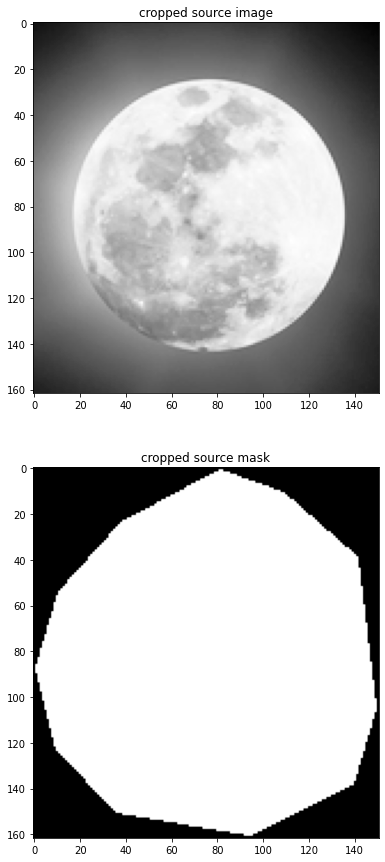

In [26]:
srcImgPath = "./images/moon3.jpeg"
srcImg = loadGrayImage(srcImgPath)
croppedSrcImg, croppedSrcMask, croppedVertices = markRegionOnSrcImg(srcImgPath, srcImg)
plot2Images(croppedSrcImg, croppedSrcMask, "cropped source image", "cropped source mask")

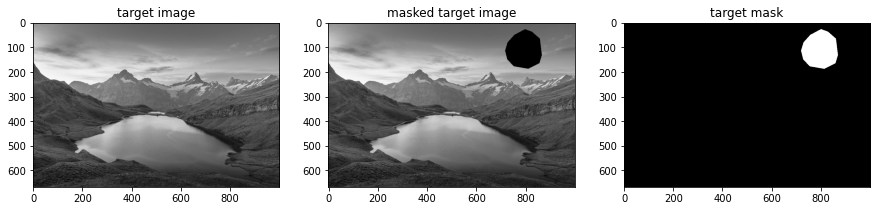

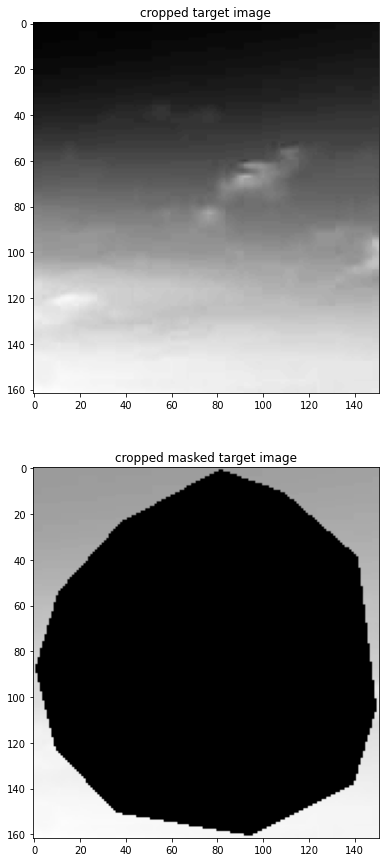

In [27]:
targetImgPath = "./images/lake1.jpeg"
targetImg = loadGrayImage(targetImgPath)
croppedTargetImg, maskedTargetImg, croppedMaskedTargetImg, targetMask, targetRect = putMarkRegionOnTargetImg(targetImgPath, targetImg, croppedSrcImg, croppedSrcMask)
plot3Images(targetImg, maskedTargetImg, targetMask, "target image", "masked target image", "target mask")
plot2Images(croppedTargetImg, croppedMaskedTargetImg, "cropped target image", "cropped masked target image")

target image: 81 158
matX:  82.94956231960809 258.2254682210494
0 255


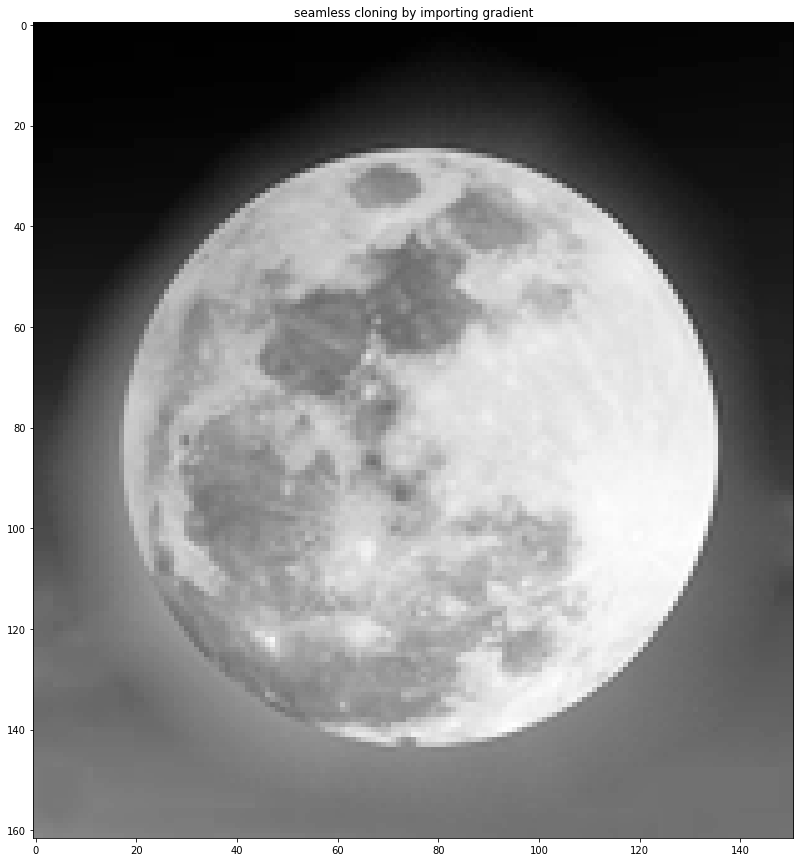

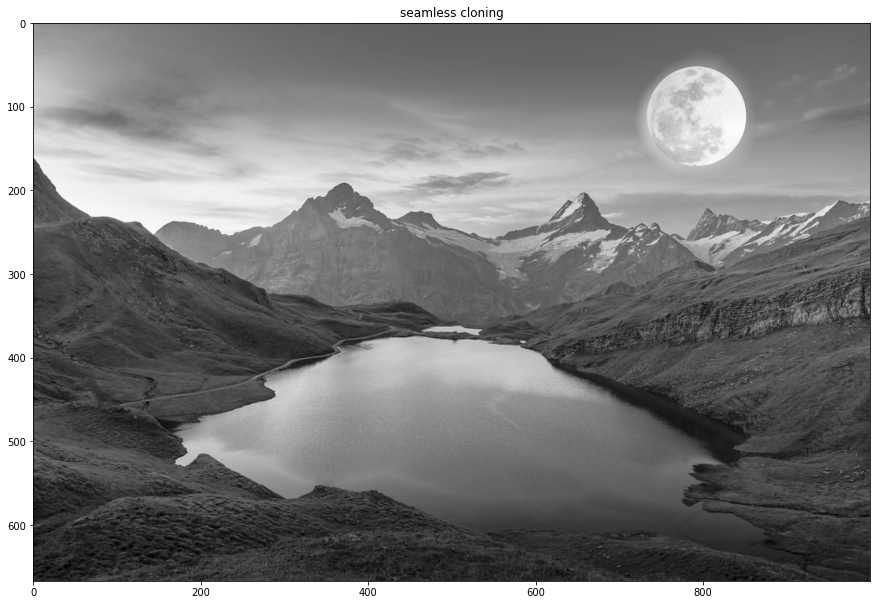

In [28]:
resultImg_ImportingGradient = seamlessCloningImportingGradient(croppedSrcImg, croppedTargetImg, croppedSrcMask)
plotImage(resultImg_ImportingGradient, "seamless cloning by importing gradient")
seamlessClonedImg = putCroppedResultImgToTarget(targetImg, resultImg_ImportingGradient, targetRect)
#print(np.amin(resultImg), np.amax(resultImg))
print(np.amin(seamlessClonedImg), np.amax(seamlessClonedImg))
plotImage(seamlessClonedImg, "seamless cloning")

Compare to direct cloning.

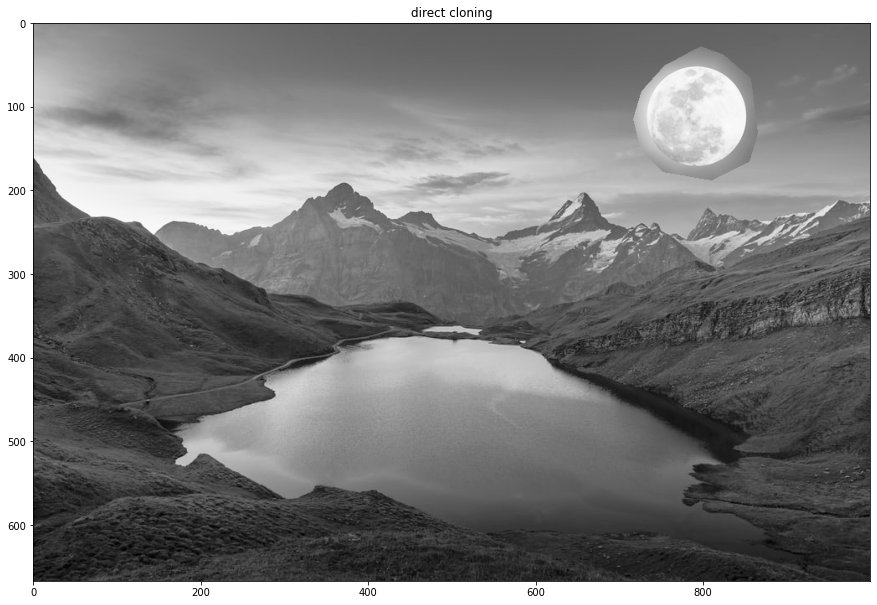

In [29]:
directClonedImg = directCloning(targetImg, targetMask, croppedSrcImg, croppedSrcMask, targetRect)
plotImage(directClonedImg, "direct cloning")

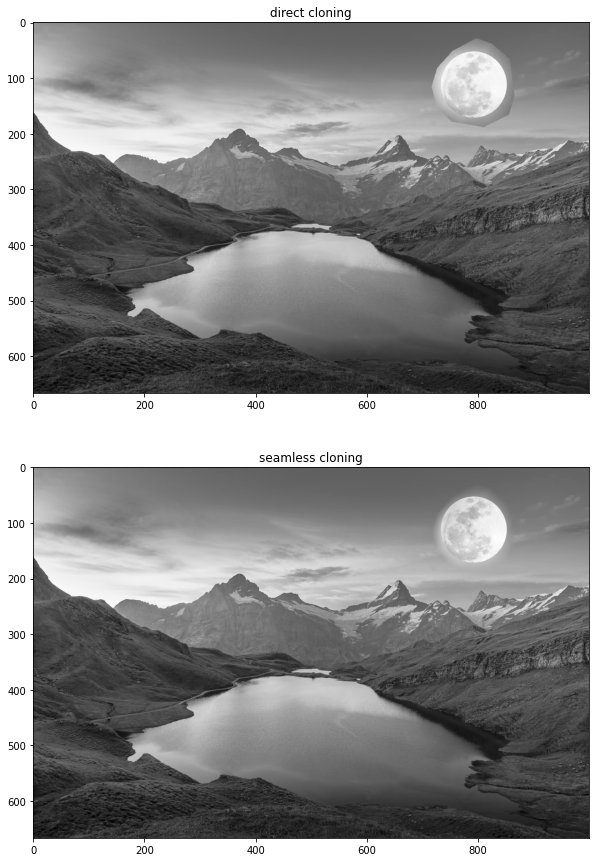

In [30]:
plot2Images(directClonedImg, seamlessClonedImg, "direct cloning", "seamless cloning")

In [31]:
cv2.imwrite("task2a.jpg", seamlessClonedImg)

True

# 4.) Task 2b - Seamless Cloning by Mixing Gradient

In [32]:
def createMatrixB_MixingGradient(srcImg, img, pointIndexMatrix, pointCoordList):
    n = len(pointCoordList)
    matB = np.zeros(n).astype(float)
    
    for i, point in enumerate(pointCoordList):
        x = point[0]
        y = point[1]
        
        centerIndex = pointIndexMatrix[y][x]
        rightIndex = pointIndexMatrix[y][x+1]
        leftIndex = pointIndexMatrix[y][x-1]
        downIndex = pointIndexMatrix[y+1][x]
        upIndex = pointIndexMatrix[y-1][x]
        
        vpq_up_src = srcImg[y][x] - srcImg[y-1][x]
        vpq_down_src = srcImg[y][x] - srcImg[y+1][x]
        vpq_left_src = srcImg[y][x] - srcImg[y][x-1]
        vpq_right_src = srcImg[y][x] - srcImg[y][x+1]
        
        vpq_up_target = img[y][x] - img[y-1][x]
        vpq_down_target = img[y][x] - img[y+1][x]
        vpq_left_target = img[y][x] - img[y][x-1]
        vpq_right_target = img[y][x] - img[y][x+1]
        
        vpq_up = 0
        vpq_down = 0
        vpq_left = 0
        vpq_right = 0
        
        if abs(vpq_up_target) > abs(vpq_up_src):
            vpq_up = vpq_up_target
        else:
            vpq_up = vpq_up_src
            
        if abs(vpq_down_target) > abs(vpq_down_src):
            vpq_down = vpq_down_target
        else:
            vpq_down = vpq_down_src
            
        if abs(vpq_left_target) > abs(vpq_left_src):
            vpq_left = vpq_left_target
        else:
            vpq_left = vpq_left_src
            
        if abs(vpq_right_target) > abs(vpq_right_src):
            vpq_right = vpq_right_target
        else:
            vpq_right = vpq_right_src
        
        gradientSum = vpq_up + vpq_down + vpq_left + vpq_right
        matB[centerIndex] = gradientSum
        
        if rightIndex == -1:
            matB[centerIndex] += img[y][x+1]
            
        if downIndex == -1:
            matB[centerIndex] += img[y+1][x]
            
        if leftIndex == -1:
            matB[centerIndex] += img[y][x-1]

        if upIndex == -1:
            matB[centerIndex] += img[y-1][x]

        
    return matB.astype(int)

In [33]:
def seamlessCloningMixingGradient(sourceImg, maskedTargetImg, targetMask):
    pointIndexMatrix, pointCoordList = getPointIndexMatrixAndPointCoordList(targetMask)
    matA = createSparseMatrixA(pointIndexMatrix, pointCoordList)
    matB = createMatrixB_MixingGradient(sourceImg, maskedTargetImg, pointIndexMatrix, pointCoordList)
    matX = linalg.cg(matA, matB)
    
    print("target image:", np.amin(maskedTargetImg), np.amax(maskedTargetImg))
    print("matX: ", np.amin(matX[0]), np.amax(matX[0]))
    
    #matXNormalise = (matX[0] - np.amin(matX[0])) / (np.amax(matX[0]) - np.amin(matX[0]))
    
    resultImg = np.array(maskedTargetImg).astype(float)
    for index, point in enumerate(pointCoordList):
        x = point[0]
        y = point[1]
        resultImg[y][x] = matX[0][index]
        #resultImg[y][x] = matXNormalise[index]
        
    resultImgFlatten = np.array(resultImg.flatten())
    resultImgFlatten[resultImgFlatten < 0] = 0
    resultImgFlatten[resultImgFlatten > 255] = 255
    resultImgClamped = resultImgFlatten.reshape(resultImg.shape[0],resultImg.shape[1])
        
    return resultImgClamped.astype(int)

In [35]:
srcImgPath = "./images/blackhole1.jpeg"
srcImg = loadGrayImage(srcImgPath)
croppedSrcImg, croppedSrcMask, croppedVertices = markRegionOnSrcImg(srcImgPath, srcImg)
#plot2Images(croppedSrcImg, croppedSrcMask, "cropped source image", "cropped source mask")
targetImgPath = "./images/universe7.jpeg"
targetImg = loadGrayImage(targetImgPath)
croppedTargetImg, maskedTargetImg, croppedMaskedTargetImg, targetMask, targetRect = putMarkRegionOnTargetImg(targetImgPath, targetImg, croppedSrcImg, croppedSrcMask)
#plot3Images(targetImg, maskedTargetImg, targetMask, "target image", "masked target image", "target mask")
#plot2Images(croppedTargetImg, croppedMaskedTargetImg, "cropped target image", "cropped masked target image")

543   196
479   260
444   342
456   441
522   498
619   543
741   531
821   473
859   366
840   267
765   178
671   162
number of vertices:  12
vertices:  [[543, 196], [479, 260], [444, 342], [456, 441], [522, 498], [619, 543], [741, 531], [821, 473], [859, 366], [840, 267], [765, 178], [671, 162]]


target image: 0 255
matX:  -53.430158908547725 383.7258447966064


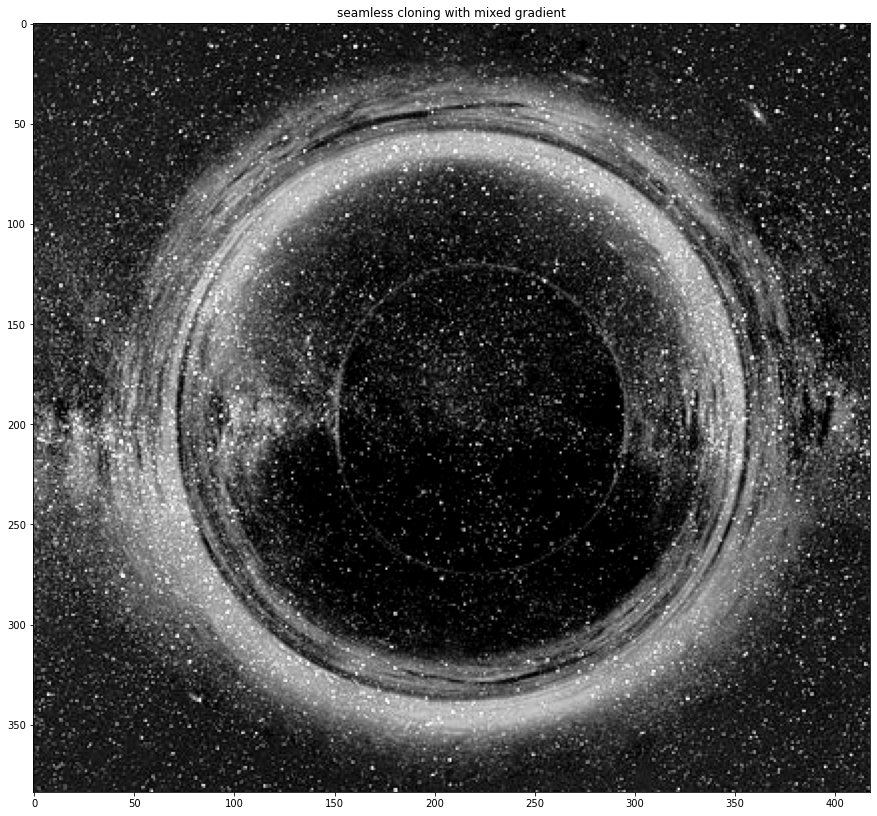

In [36]:
resultImg_MixingGradient = seamlessCloningMixingGradient(croppedSrcImg.astype(np.int32), croppedTargetImg.astype(np.int32), croppedSrcMask.astype(np.int32))
plotImage(resultImg_MixingGradient, "seamless cloning with mixed gradient")

0 255


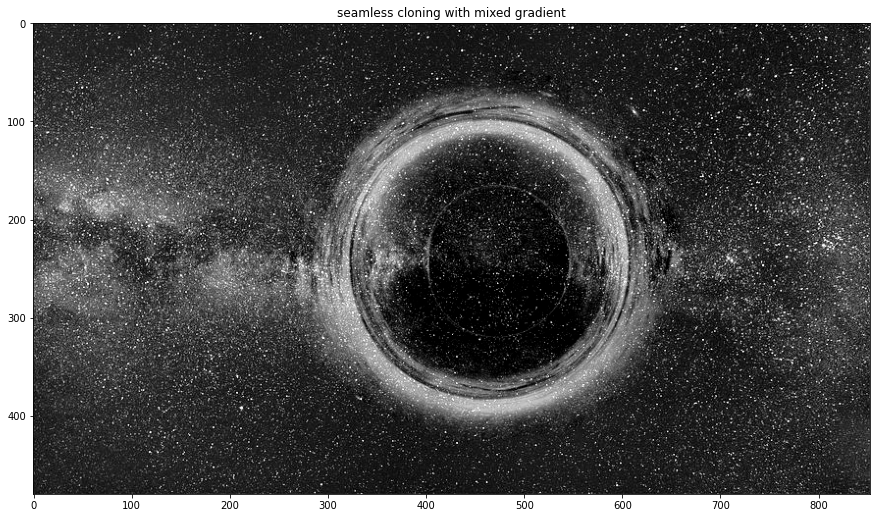

In [37]:
seamlessClonedImg_MixedGrad = putCroppedResultImgToTarget(targetImg, resultImg_MixingGradient, targetRect)
#print(np.amin(resultImg), np.amax(resultImg))
print(np.amin(seamlessClonedImg_MixedGrad), np.amax(seamlessClonedImg_MixedGrad))
plotImage(seamlessClonedImg_MixedGrad, "seamless cloning with mixed gradient")

In [38]:
cv2.imwrite("task2b.jpg", seamlessClonedImg_MixedGrad)

True

Compare to direct cloning.

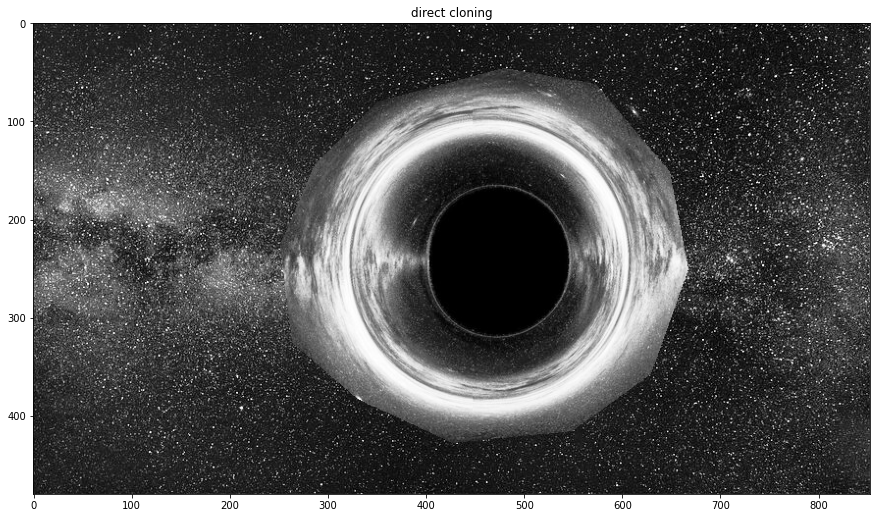

In [39]:
directClonedImg = directCloning(targetImg, targetMask, croppedSrcImg, croppedSrcMask, targetRect)
plotImage(directClonedImg, "direct cloning")

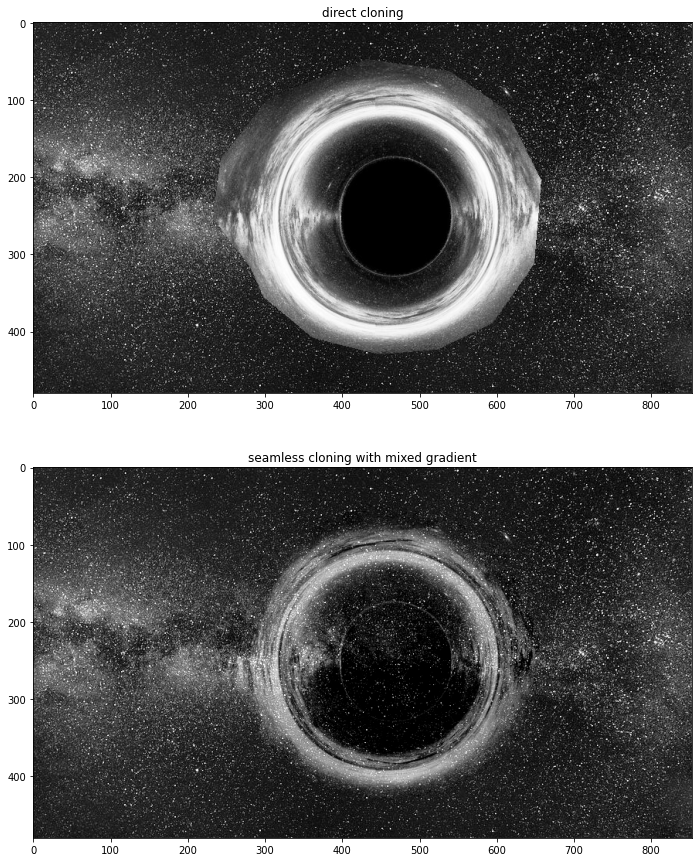

In [39]:
plot2Images(directClonedImg, seamlessClonedImg_MixedGrad, "direct cloning", "seamless cloning with mixed gradient")

Compare with no mixed gradient.

target image: 0 255
matX:  -53.33504754389147 231.6404450707661


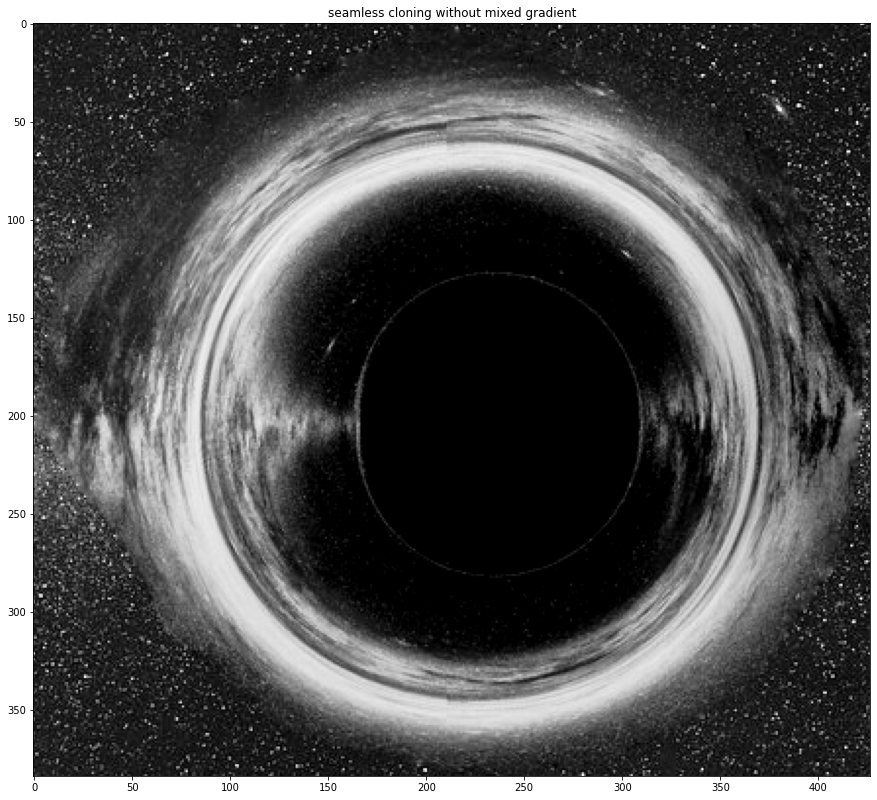

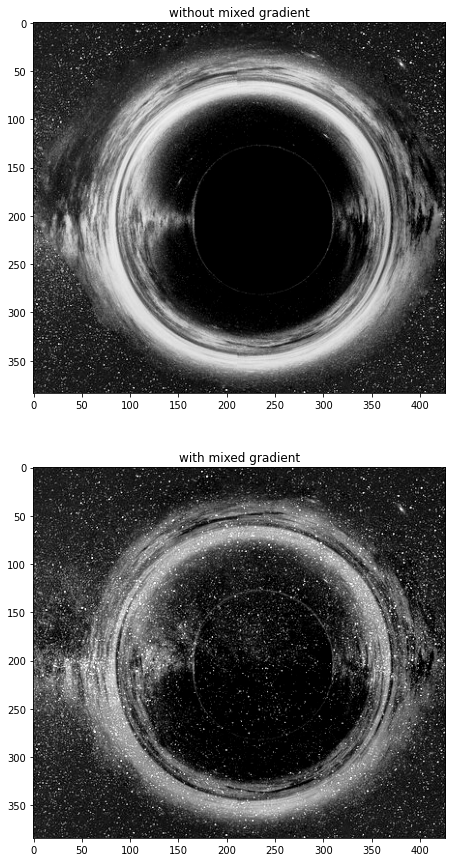

In [40]:
resultImg_ImportingGradient = seamlessCloningImportingGradient(croppedSrcImg, croppedTargetImg, croppedSrcMask)
plotImage(resultImg_ImportingGradient, "seamless cloning without mixed gradient")
plot2Images(resultImg_ImportingGradient, resultImg_MixingGradient, "without mixed gradient", "with mixed gradient" )

0 255


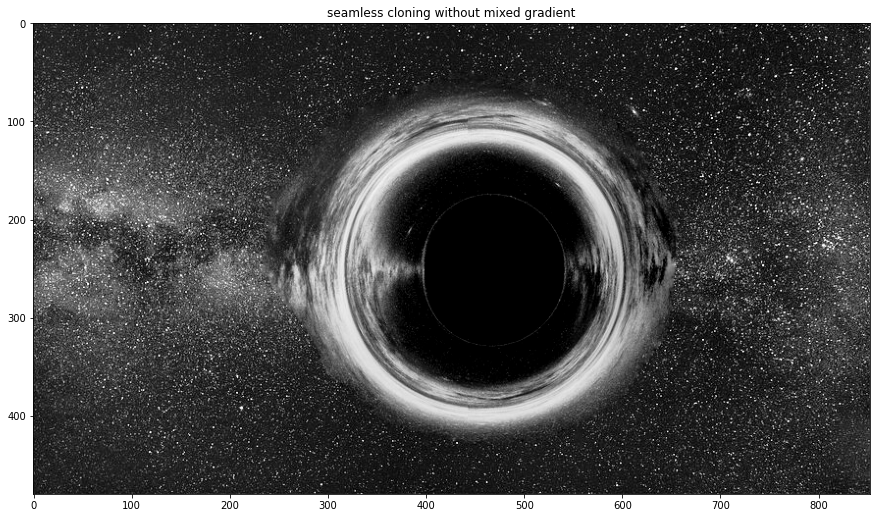

In [41]:
seamlessClonedImg_ImportGrad = putCroppedResultImgToTarget(targetImg, resultImg_ImportingGradient, targetRect)
#print(np.amin(resultImg), np.amax(resultImg))
print(np.amin(seamlessClonedImg_ImportGrad), np.amax(seamlessClonedImg_ImportGrad))
plotImage(seamlessClonedImg_ImportGrad, "seamless cloning without mixed gradient")

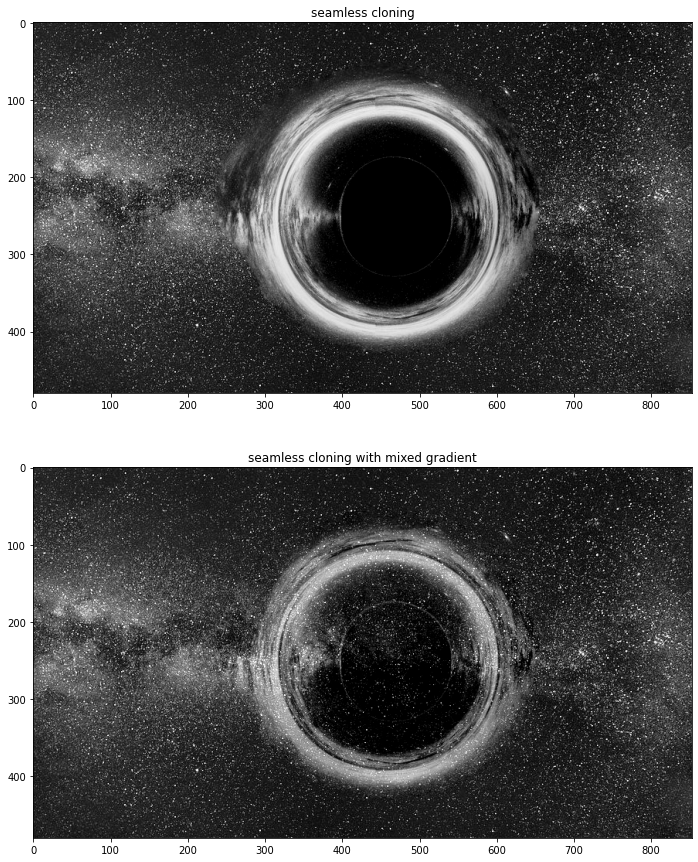

In [42]:
plot2Images(seamlessClonedImg_ImportGrad, seamlessClonedImg_MixedGrad, "seamless cloning", "seamless cloning with mixed gradient")

# 5.) Task 3 - Seamless Cloning on Color Image

In [43]:
def seamlessCloningImportingGradient_ColorImg(sourceImg, maskedTargetImg, targetMask3):
    targetMask = np.array(targetMask3[:,:,0]).reshape(targetMask3.shape[0], targetMask3.shape[1])
    pointIndexMatrix, pointCoordList = getPointIndexMatrixAndPointCoordList(targetMask)
    matA = createSparseMatrixA(pointIndexMatrix, pointCoordList)
    
    resultImg = np.array(maskedTargetImg).astype(float)
    
    for channel in range(3):
        src = sourceImg[:,:,channel].reshape(sourceImg.shape[0], sourceImg.shape[1])
        target = maskedTargetImg[:,:,channel].reshape(maskedTargetImg.shape[0],maskedTargetImg.shape[1])
        matB = createMatrixB_ImportingGradient(src, target, pointIndexMatrix, pointCoordList)
        matX = linalg.cg(matA, matB)

        for index, point in enumerate(pointCoordList):
            x = point[0]
            y = point[1]
            resultImg[y][x][channel] = matX[0][index]
            
    resultImgFlatten = np.array(resultImg.flatten())
    resultImgFlatten[resultImgFlatten < 0] = 0
    resultImgFlatten[resultImgFlatten > 255] = 255
    resultImgClamped = resultImgFlatten.reshape(resultImg.shape[0],resultImg.shape[1],3)
        
    return resultImgClamped.astype(int)

In [44]:
def seamlessCloningMixingGradient_ColorImg(sourceImg, maskedTargetImg, targetMask3):
    targetMask = np.array(targetMask3[:,:,0]).reshape(targetMask3.shape[0], targetMask3.shape[1])
    pointIndexMatrix, pointCoordList = getPointIndexMatrixAndPointCoordList(targetMask)
    matA = createSparseMatrixA(pointIndexMatrix, pointCoordList)
    
    resultImg = np.array(maskedTargetImg).astype(float)
    
    for channel in range(3):
        src = sourceImg[:,:,channel].reshape(sourceImg.shape[0], sourceImg.shape[1])
        target = maskedTargetImg[:,:,channel].reshape(maskedTargetImg.shape[0],maskedTargetImg.shape[1])
        matB = createMatrixB_MixingGradient(src, target, pointIndexMatrix, pointCoordList)
        matX = linalg.cg(matA, matB)

        for index, point in enumerate(pointCoordList):
            x = point[0]
            y = point[1]
            resultImg[y][x][channel] = matX[0][index]
            
    resultImgFlatten = np.array(resultImg.flatten())
    resultImgFlatten[resultImgFlatten < 0] = 0
    resultImgFlatten[resultImgFlatten > 255] = 255
    resultImgClamped = resultImgFlatten.reshape(resultImg.shape[0],resultImg.shape[1],3)
        
    return resultImgClamped.astype(int)

502   256
445   364
466   478
537   555
653   582
769   554
824   495
851   418
833   319
762   226
651   195
577   193
number of vertices:  12
vertices:  [[502, 256], [445, 364], [466, 478], [537, 555], [653, 582], [769, 554], [824, 495], [851, 418], [833, 319], [762, 226], [651, 195], [577, 193]]


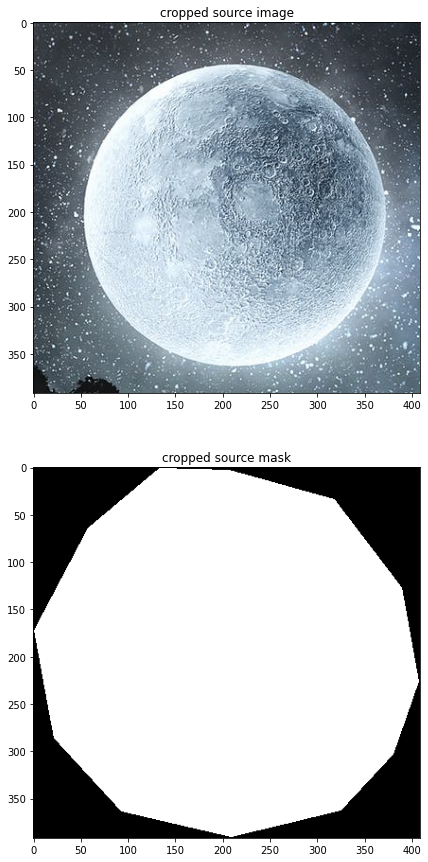

In [45]:
srcImgPath = "./images/moon21.jpeg"
srcImg = loadImage(srcImgPath)
croppedSrcImg, croppedSrcMask, croppedVertices = markRegionOnSrcImg(srcImgPath, srcImg)
plot2Images(croppedSrcImg, croppedSrcMask.astype(float), "cropped source image", "cropped source mask")

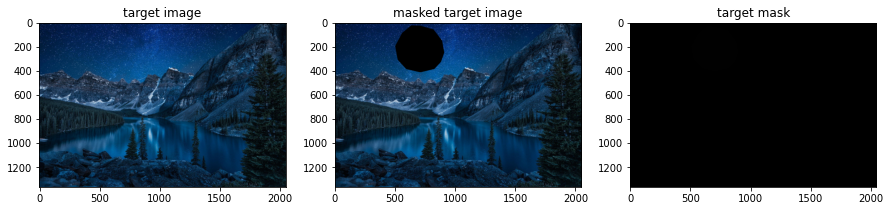

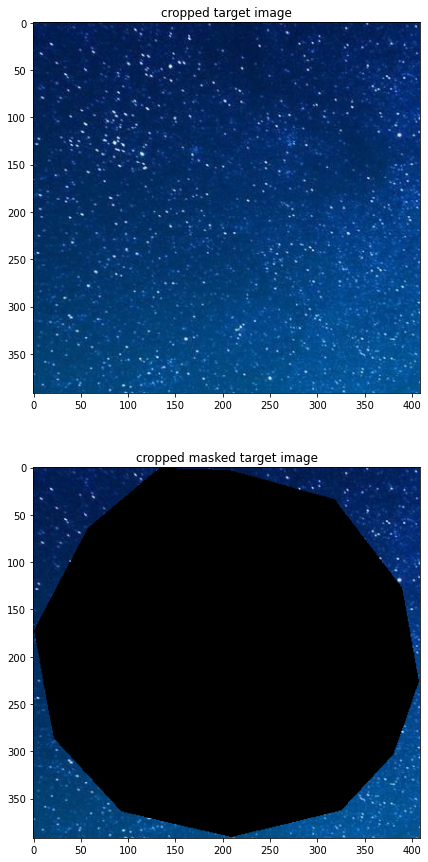

In [46]:
targetImgPath = "./images/mountain2.jpeg"
targetImg = loadImage(targetImgPath)
croppedTargetImg, maskedTargetImg, croppedMaskedTargetImg, targetMask, targetRect = putMarkRegionOnTargetImg(targetImgPath, targetImg, croppedSrcImg, croppedSrcMask)
plot3Images(targetImg, maskedTargetImg, targetMask, "target image", "masked target image", "target mask")
plot2Images(croppedTargetImg, croppedMaskedTargetImg, "cropped target image", "cropped masked target image")

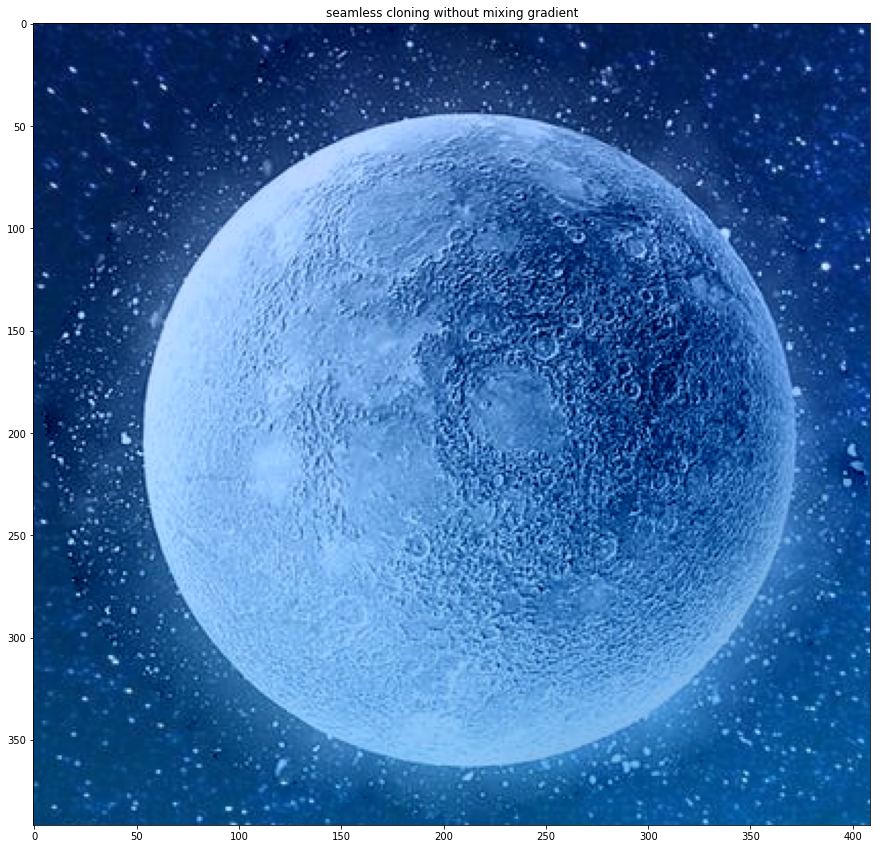

In [47]:
resultImg_ImportGrad = seamlessCloningImportingGradient_ColorImg(croppedSrcImg, croppedTargetImg, croppedSrcMask)
plotImage(resultImg_ImportGrad, "seamless cloning without mixing gradient")

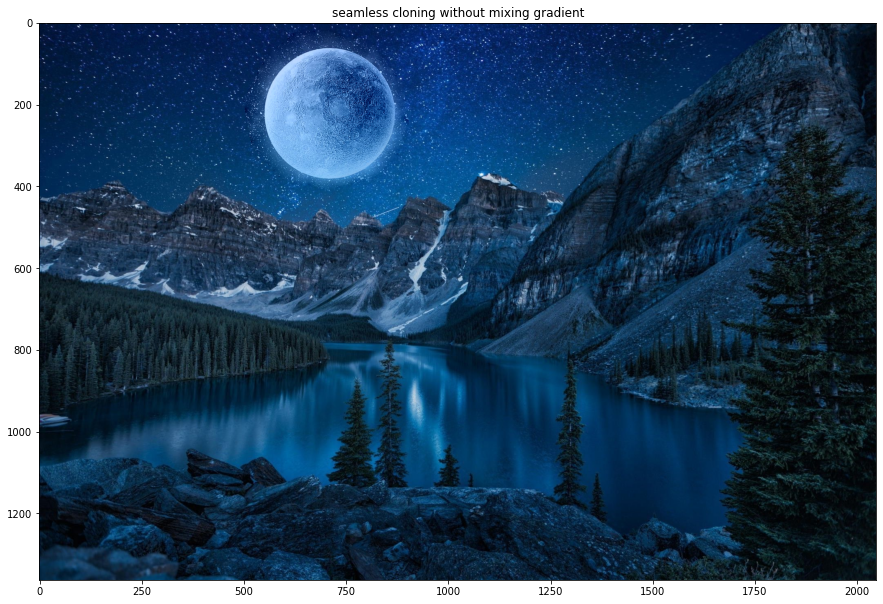

In [48]:
seamlessClonedImg_ImportGrad = putCroppedResultImgToTarget(targetImg, resultImg_ImportGrad, targetRect)
plotImage(seamlessClonedImg_ImportGrad, "seamless cloning without mixing gradient")

Compare to direct cloning.

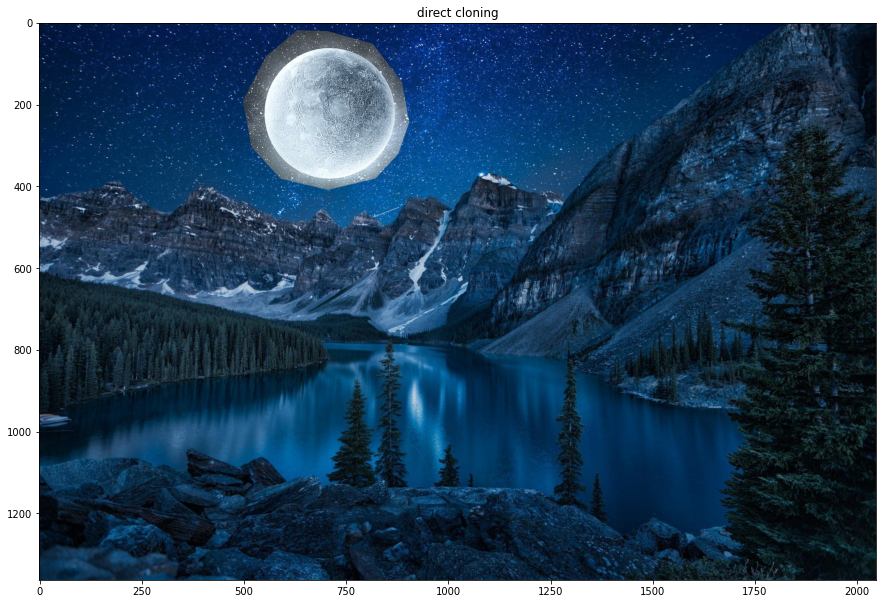

In [49]:
directClonedImg = directCloning(targetImg, targetMask, croppedSrcImg, croppedSrcMask, targetRect)
plotImage(directClonedImg, "direct cloning")

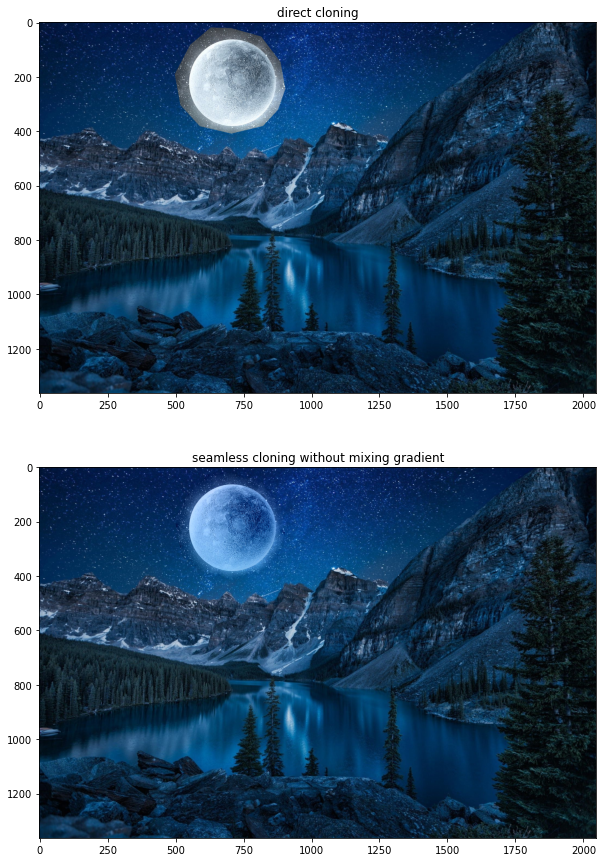

In [50]:
plot2Images(directClonedImg, seamlessClonedImg_ImportGrad, "direct cloning", "seamless cloning without mixing gradient")

In [51]:
cv2.imwrite("task3_seamless.jpg", seamlessClonedImg_ImportGrad)

True

## Mixing gradient.

In [52]:
srcImgPath = "./images/blackhole1.jpeg"
srcImg = loadImage(srcImgPath)
croppedSrcImg, croppedSrcMask, croppedVertices = markRegionOnSrcImg(srcImgPath, srcImg)
#plot2Images(croppedSrcImg, croppedSrcMask, "cropped source image", "cropped source mask")
targetImgPath = "./images/universe7.jpeg"
targetImg = loadImage(targetImgPath)
croppedTargetImg, maskedTargetImg, croppedMaskedTargetImg, targetMask, targetRect = putMarkRegionOnTargetImg(targetImgPath, targetImg, croppedSrcImg, croppedSrcMask)
#plot3Images(targetImg, maskedTargetImg, targetMask, "target image", "masked target image", "target mask")
#plot2Images(croppedTargetImg, croppedMaskedTargetImg, "cropped target image", "cropped masked target image")

501   229
450   298
451   362
474   437
532   505
606   541
734   527
802   487
834   450
863   374
868   298
821   233
758   176
651   157
553   163
number of vertices:  15
vertices:  [[501, 229], [450, 298], [451, 362], [474, 437], [532, 505], [606, 541], [734, 527], [802, 487], [834, 450], [863, 374], [868, 298], [821, 233], [758, 176], [651, 157], [553, 163]]


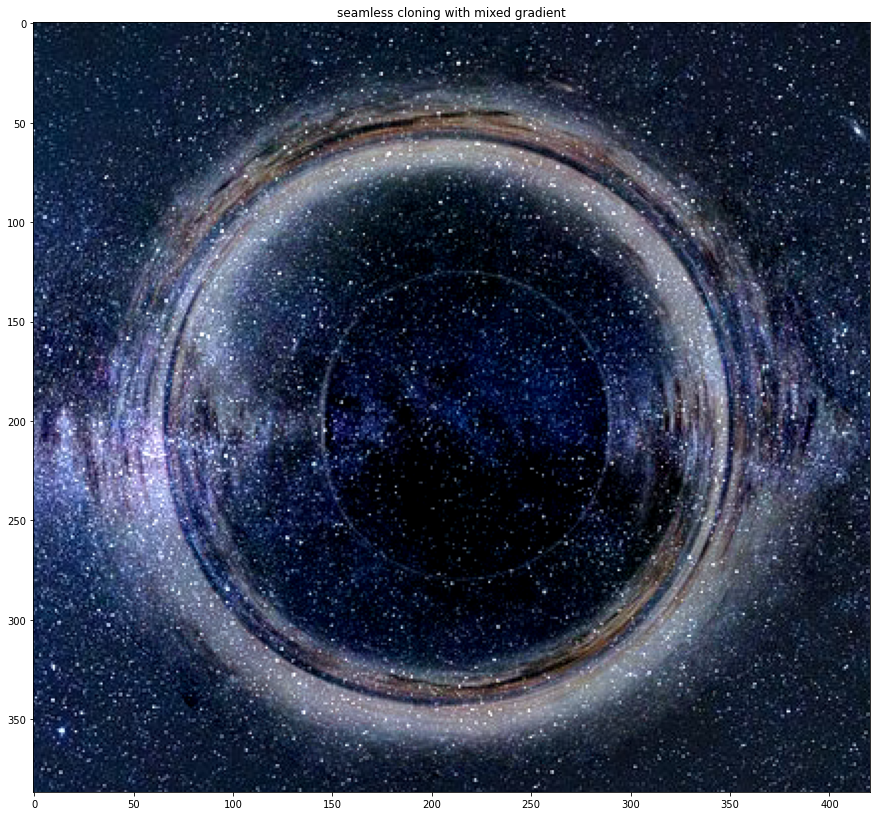

In [53]:
resultImg_MixedGrad = seamlessCloningMixingGradient_ColorImg(croppedSrcImg.astype(np.int32), croppedTargetImg.astype(np.int32), croppedSrcMask.astype(np.int32))
plotImage(resultImg_MixedGrad, "seamless cloning with mixed gradient")

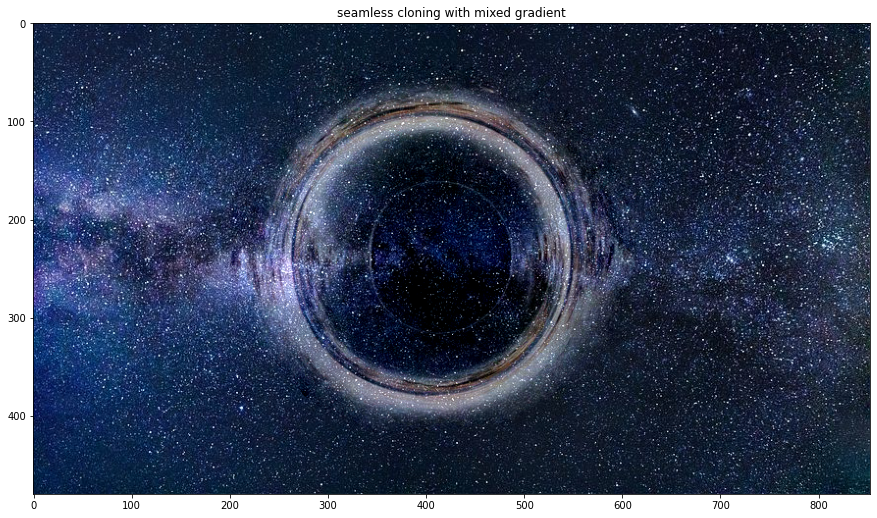

In [54]:
seamlessClonedImg_MixedGrad = putCroppedResultImgToTarget(targetImg, resultImg_MixedGrad, targetRect)
plotImage(seamlessClonedImg_MixedGrad, "seamless cloning with mixed gradient")

In [55]:
cv2.imwrite("task3_mixedGrad.jpg", seamlessClonedImg_MixedGrad)

True

Compare to direct cloning and without mixed gradient.

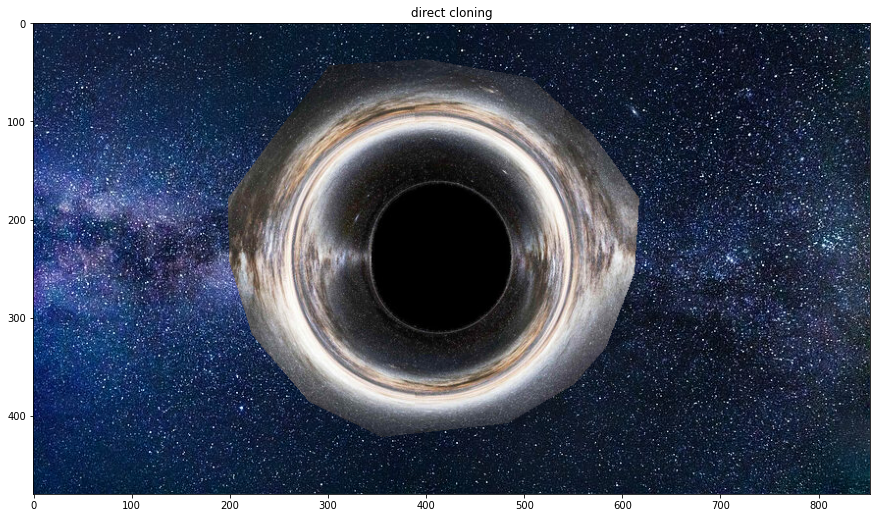

In [56]:
directClonedImg = directCloning(targetImg, targetMask, croppedSrcImg, croppedSrcMask, targetRect)
plotImage(directClonedImg, "direct cloning")

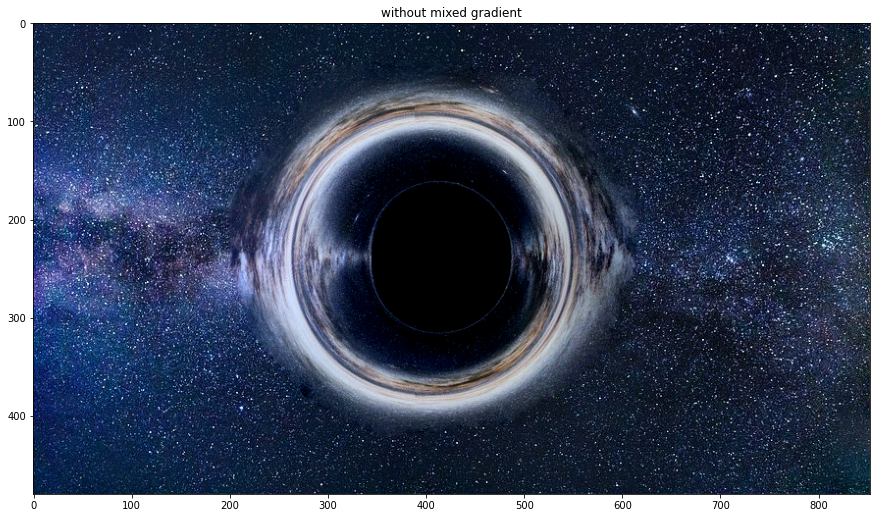

In [57]:
resultImg_ImportGrad = seamlessCloningImportingGradient_ColorImg(croppedSrcImg, croppedTargetImg, croppedSrcMask)
seamlessClonedImg_ImportGrad = putCroppedResultImgToTarget(targetImg, resultImg_ImportGrad, targetRect)
plotImage(seamlessClonedImg_ImportGrad, "without mixed gradient")

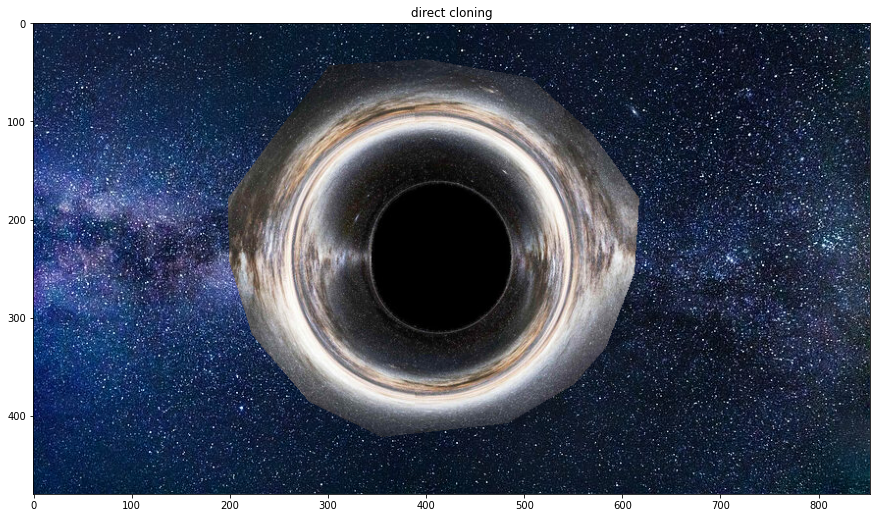

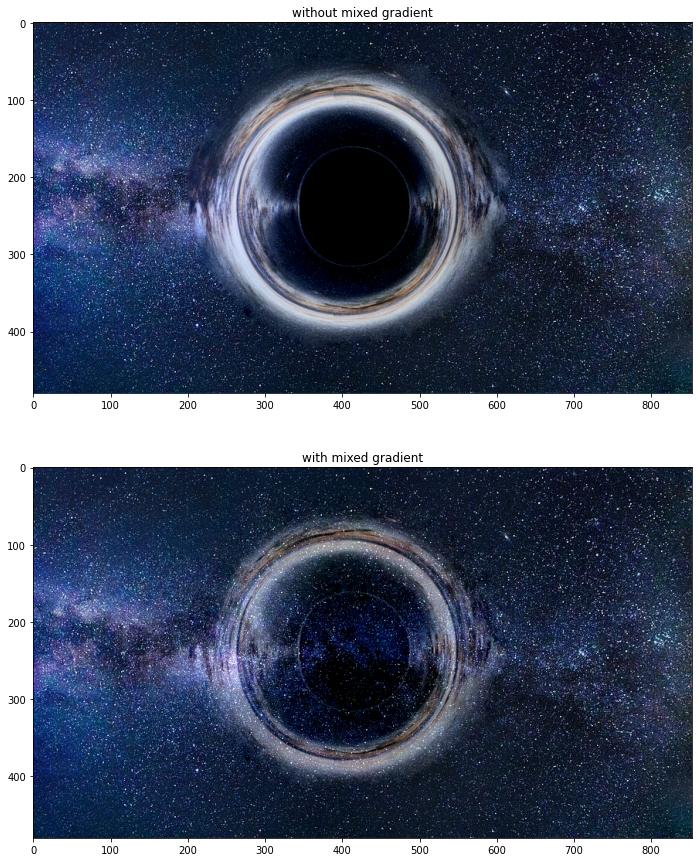

In [58]:
plotImage(directClonedImg, "direct cloning")
plot2Images(seamlessClonedImg_ImportGrad, seamlessClonedImg_MixedGrad, "without mixed gradient", "with mixed gradient")

# 6.) Task 4 - Texture Flattening

uint8


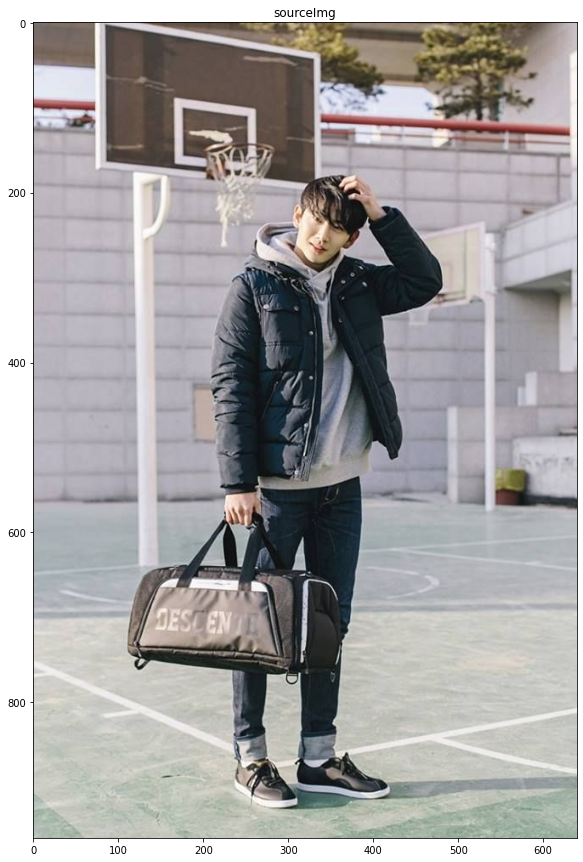

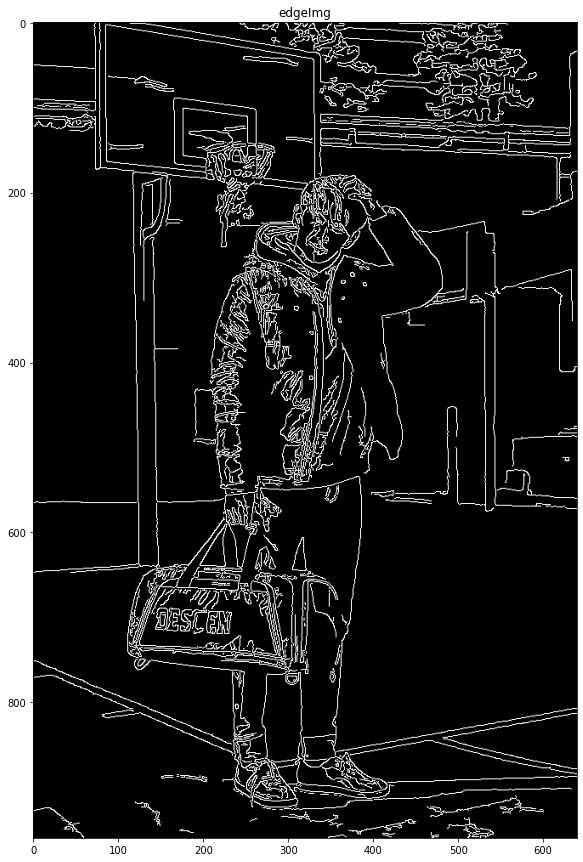

In [40]:
srcImgPath = "./images/model3.jpeg"
srcImg = loadImage(srcImgPath)
plotImage(srcImg, "sourceImg")
edgeImg = cv2.Canny(srcImg, 50, 150, L2gradient=True)
plotImage(edgeImg, "edgeImg")
print(edgeImg.dtype)

In [41]:
def createMatrixB_textureFlatten(img, edgeImg, pointIndexMatrix, pointCoordList):
    n = len(pointCoordList)
    matB = np.zeros(n)
    threshold = 127 if edgeImg.dtype == np.uint8 else 0.5
    
    for point in pointCoordList:
        x = point[0]
        y = point[1]
        
        centerIndex = pointIndexMatrix[y][x]
        rightIndex = pointIndexMatrix[y][x+1]
        leftIndex = pointIndexMatrix[y][x-1]
        downIndex = pointIndexMatrix[y+1][x]
        upIndex = pointIndexMatrix[y-1][x]
        
        vpq_up = 0
        vpq_down = 0
        vpq_left = 0
        vpq_right = 0
        
        imgCenter = img[y][x]
        imgRight = img[y][x+1]
        imgLeft = img[y][x-1]
        imgDown = img[y+1][x]
        imgUp = img[y-1][x]
        
        edgeImgCenter = edgeImg[y][x]
        edgeImgRight = edgeImg[y][x+1]
        edgeImgLeft = edgeImg[y][x-1]
        edgeImgDown = edgeImg[y+1][x]
        edgeImgUp = edgeImg[y-1][x]
        
        if edgeImgCenter > threshold or edgeImgUp > threshold:
            vpq_up = float(imgCenter) - float(imgUp)
        else:
            vpq_up = 0.0;
            
        if edgeImgCenter > threshold or edgeImgDown > threshold:
            vpq_down = float(imgCenter) - float(imgDown)
        else:
            vpq_down = 0.0;
        
        if edgeImgCenter > threshold or edgeImgRight > threshold:
            vpq_right = float(imgCenter) - float(imgRight)
        else:
            vpq_right = 0.0;
        
        if edgeImgCenter > threshold or edgeImgLeft > threshold:
            vpq_left = float(imgCenter) - float(imgLeft)
        else:
            vpq_left = 0.0;

        
        gradientSum = vpq_up + vpq_down + vpq_left + vpq_right
        matB[centerIndex] = gradientSum
        
        if rightIndex == -1:
            matB[centerIndex] += img[y][x+1]
            
        if downIndex == -1:
            matB[centerIndex] += img[y+1][x]
            
        if leftIndex == -1:
            matB[centerIndex] += img[y][x-1]

        if upIndex == -1:
            matB[centerIndex] += img[y-1][x]
        
    return matB

In [42]:
def texture_flattening(imgPath, img, edgeImg):
    # select a region on the image and get a list of vertices coordinates
    vertices = getRegionVerticesFromImg(imgPath)
    # get a mask using the vertices list
    mask = getMaskByVertices(img[:,:,0], vertices)
    # create a matrix to store the index of the pixel that is within the selected region
    # also store those pixel's coordinate to a list
    pointIndexMatrix, pointCoordList = getPointIndexMatrixAndPointCoordList(mask)
    # Linear Equation: Ax = B, solving for x which is the unknown intensity inside the selected region
    matA = createSparseMatrixA(pointIndexMatrix, pointCoordList)
    
    resultImg = np.array(img).astype(float)
    for channel in range(3):
        matB = createMatrixB_textureFlatten(img[:,:,channel], edgeImg, pointIndexMatrix, pointCoordList)
        matX = linalg.cg(matA, matB)
        # put solved intensity value back to the corresponding position for each pixel
        for index, point in enumerate(pointCoordList):
            x = point[0]
            y = point[1]
            resultImg[y][x][channel] = matX[0][index]
            
    resultImgFlatten = np.array(resultImg.flatten())
    resultImgFlatten[resultImgFlatten < 0] = 0
    resultImgFlatten[resultImgFlatten > 255] = 255
    resultImgClamped = resultImgFlatten.reshape(resultImg.shape[0],resultImg.shape[1],3)
        
    return resultImgClamped.astype(int)

295   202
266   227
230   266
217   300
202   347
189   405
189   467
195   555
175   612
110   642
86   694
86   740
102   776
196   802
279   796
339   795
401   743
383   636
408   584
443   533
443   462
430   386
498   325
498   254
442   199
381   162
318   162
number of vertices:  27
vertices:  [[295, 202], [266, 227], [230, 266], [217, 300], [202, 347], [189, 405], [189, 467], [195, 555], [175, 612], [110, 642], [86, 694], [86, 740], [102, 776], [196, 802], [279, 796], [339, 795], [401, 743], [383, 636], [408, 584], [443, 533], [443, 462], [430, 386], [498, 325], [498, 254], [442, 199], [381, 162], [318, 162]]


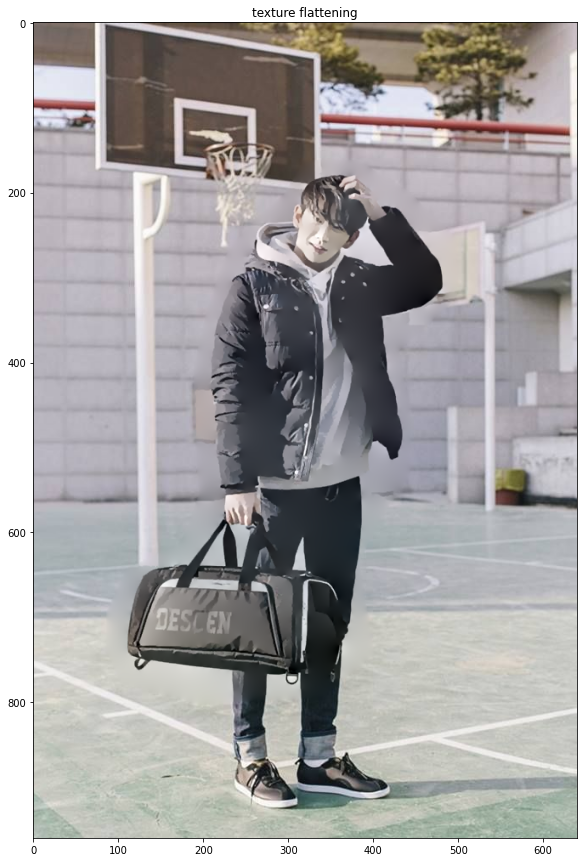

In [43]:
targetImgPath = "./images/model3.jpeg"
targetImg = loadImage(targetImgPath)
edgeImg = cv2.Canny(targetImg, 50, 150, L2gradient=True)
resultImg_textureFlatten = texture_flattening(targetImgPath, targetImg, edgeImg)
plotImage(resultImg_textureFlatten, "texture flattening")